By Mohammad Mahdi Mirza Ali Mohammadi (Hamed Mohammadi)

In [9]:
!git clone 'https://github.com/farhadi76m/Machine-vision-spring-2023.git'

Cloning into 'Machine-vision-spring-2023'...
remote: Enumerating objects: 142, done.
remote: Counting objects: 100% (142/142), done.
remote: Compressing objects: 100% (118/118), done.
remote: Total 142 (delta 45), reused 91 (delta 16), pack-reused 0
Receiving objects: 100% (142/142), 33.30 MiB | 28.36 MiB/s, done.
Resolving deltas: 100% (45/45), done.


In [4]:
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

# 1_a) Create checkerboard pattern

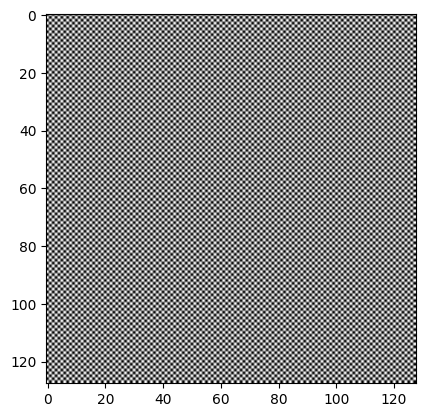

In [ ]:

# Python program to print nXn Assuming that n
# is always even as a checkerboard was

def printcheckboard(n):
    final = []
    for i in range(n):
        final.append(list(np.tile([0,1],int(n/2))) if i%2==0 else list(np.tile([1,0],int(n/2))))
    return np.array(final, dtype=np.uint8)


# driver code
n = 128
ch_ar = printcheckboard(n)
ch_ar = ch_ar * 255  # Scale the values to the full grayscale range

# Convert the array to an image
# ch_img = Image.fromarray(ch_ar.astype(np.uint8))
# ch_img.show()  # Display the image

im = plt.imshow(ch_ar, cmap="gray")
plt.show()


# 1_b) Random RGB image

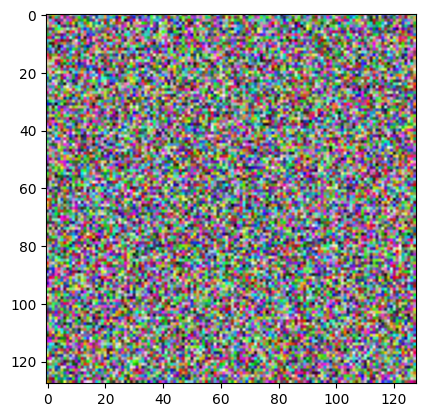

In [ ]:
def create_random_image(width, height):
    # Generate random RGB image
    rand_img = np.random.randint(0, 255, size=(width, height, 3), dtype=np.uint8)
    
    # Display the image
    plt.imshow(rand_img)
    plt.show()

create_random_image(128, 128)

# 1_c) draw a shape on an image

In [ ]:
def draw_shape_on_image(image, shape_type, x, y, color, size, thickness):
    if shape_type == 'circle':
        cv2.circle(image, (x, y), size, color, thickness)
    elif shape_type == 'rectangle':
        half_size = size // 2
        top_left = (x - half_size, y - half_size)
        bottom_right = (x + half_size, y + half_size)
        cv2.rectangle(image, top_left, bottom_right, color, thickness)
    else:
        raise ValueError("Invalid shape_type. Only 'circle' and 'rectangle' are supported.")


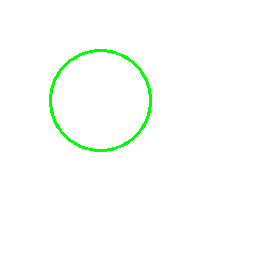

In [ ]:
# Load an image
white_image = 255 *np.ones((256, 256, 3), dtype=np.uint8)

# Specify the parameters
shape_type = 'circle'
x = 100
y = 100
color = (0, 255, 0)  # Green color (in BGR format)
size = 50
thickness = 2

# Draw the shape on the image
draw_shape_on_image(white_image, shape_type, x, y, color, size, thickness)

# Display the image with the shape
cv2_imshow(white_image)


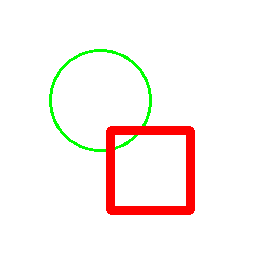

In [ ]:
# Specify the parameters
shape_type = 'rectangle'
x = 150
y = 170
color = (0, 0, 255)
size = 80
thickness = 8

# Draw the shape on the image
draw_shape_on_image(white_image, shape_type, x, y, color, size, thickness)

# Display the image with the shape
cv2_imshow(white_image)

# 2_a) Histogram of the image

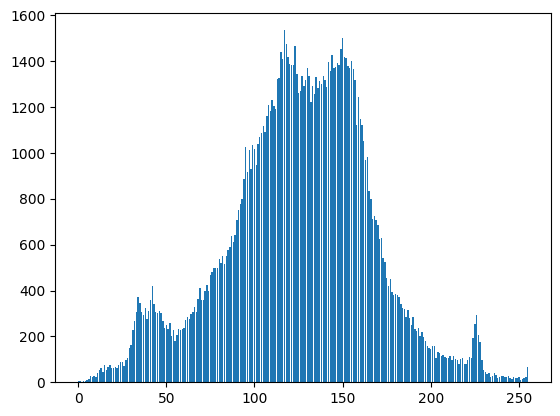

In [ ]:
# you can change the path to see the histogram of the image you want
img_path = '/content/Machine-vision-spring-2023/homework4/iguana.png'

def draw_hist(path):
  img_1 = cv2.imread(path)
  hist = cv2.calcHist([img_1],[0],None,[256],[0,256])

  plt.bar(range(len(hist)), hist.flatten())
  plt.show()

draw_hist(img_path)

# 2_b) Normalization 0 to 1

Image data before normalization:
 [[ 26  26  26 ... 221 219 214]
 [ 29  29  28 ... 208 207 206]
 [ 28  29  28 ... 198 197 195]
 ...
 [103 104 117 ... 116 114 113]
 [103  87  92 ... 122 120 117]
 [107  83  82 ... 126 124 123]]
Image data after normalization:
 [[0.10196079 0.10196079 0.10196079 ... 0.86666673 0.8588236  0.83921576]
 [0.1137255  0.1137255  0.10980393 ... 0.81568635 0.8117648  0.8078432 ]
 [0.10980393 0.1137255  0.10980393 ... 0.77647066 0.7725491  0.76470596]
 ...
 [0.4039216  0.40784317 0.45882356 ... 0.454902   0.44705886 0.4431373 ]
 [0.4039216  0.34117648 0.36078432 ... 0.4784314  0.47058827 0.45882356]
 [0.41960788 0.3254902  0.32156864 ... 0.49411768 0.48627454 0.48235297]]


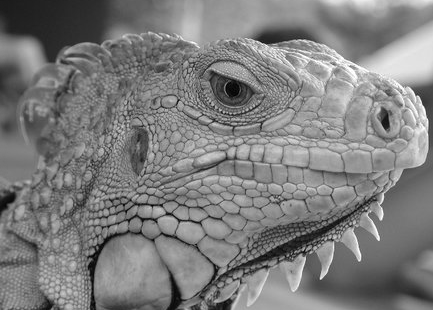

In [ ]:
# you can change the path to try the function for other images
# img_path_road = '/content/Machine-vision-spring-2023/homework4/road.jpg'

# read the input image
img2 = cv2.imread(img_path, 0)

def normalize_0_1(img):
    # normalize the image
    img_normalized = cv2.normalize(img2, None, alpha=0, beta=1.0, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    return img_normalized

normalized_img = normalize_0_1(img2)
# print the image data before and after normalization
print("Image data before normalization:\n", img2)
print("Image data after normalization:\n", normalized_img)

# display the image
cv2_imshow(img2)
# cv2_imshow(normalized_img)


# 2_c) Enhance the histogram

According to the images shown below, the CLAHE method performs best

## CLAHE:

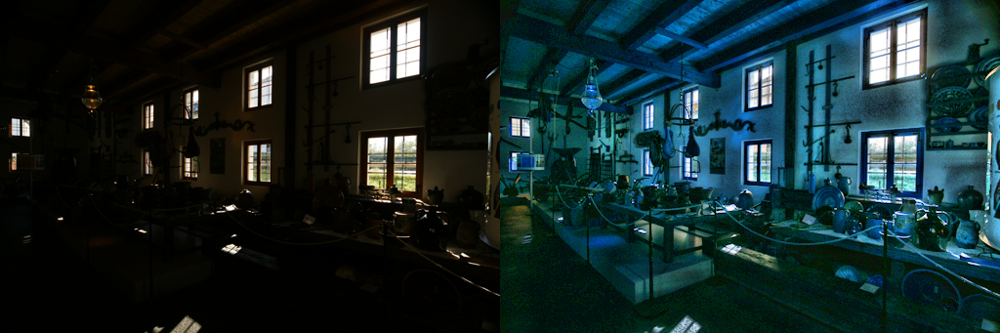

In [ ]:
img_path_3 = '/content/Machine-vision-spring-2023/homework4/image_enhancement/Farmhouse.jpg'

# Reading the image
img3 = cv2.imread(img_path_3)

# split to h, s, v
hsv_img = cv2.cvtColor(img3, cv2.COLOR_BGR2HSV)
h, s, v = hsv_img[:,:,0], hsv_img[:,:,1], hsv_img[:,:,2]

# create and apply clahe
clahe = cv2.createCLAHE(clipLimit=15.0, tileGridSize = (20,20))
v = clahe.apply(v)

# rebuild the image
hsv_img = np.dstack((h,s,v))
rgb = cv2.cvtColor(hsv_img, cv2.COLOR_HSV2RGB)

# Show the two images
res_clahe = np.hstack((img3, rgb))
cv2_imshow(res_clahe)

## GHE:

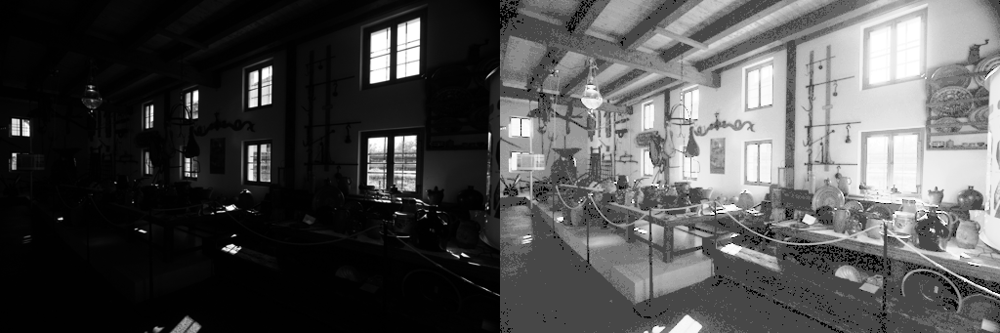

In [ ]:
# img_path_3 = '/content/Machine-vision-spring-2023/homework4/image_enhancement/Farmhouse.jpg'
# img3 = cv2.imread(img_path_3)

gray_img = cv2.cvtColor(img3, cv2.COLOR_BGR2GRAY)
equ = cv2.equalizeHist(gray_img)

# show the two images
res = np.hstack((gray_img,equ)) #stacking images side-by-side
cv2_imshow(res)


## BBHE:

In [ ]:
!pip install image-enhancement
from image_enhancement import image_enhancement

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


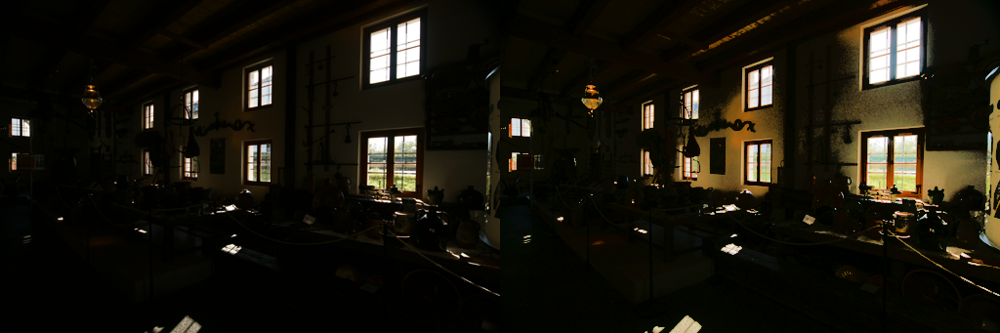

In [ ]:

ie = image_enhancement.IE(img3, color_space = 'HSV')
equ_bbhe = ie.BBHE()

# show the two images
res_bbhe = np.hstack((img3,equ_bbhe)) #stacking images side-by-side
cv2_imshow(res_bbhe)

# 3_a) add noise 

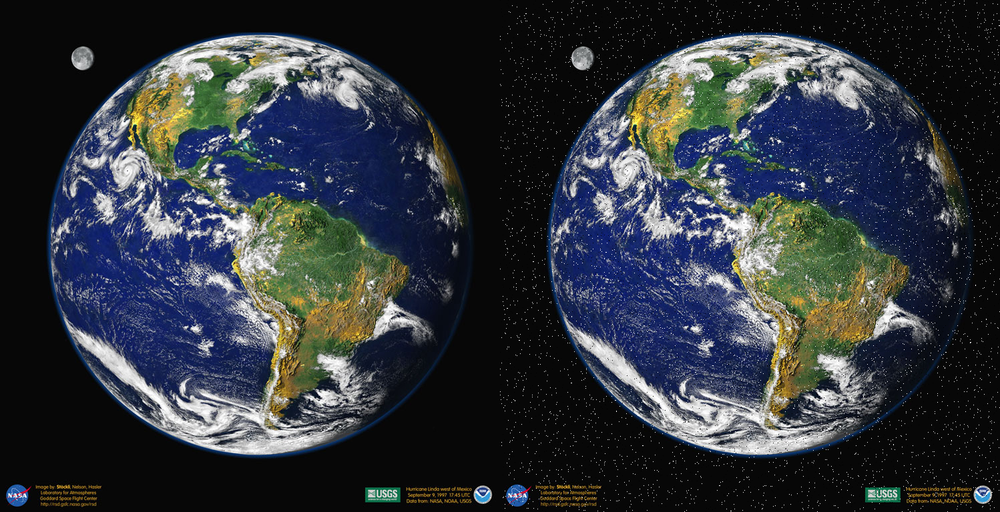

In [ ]:
def noisy(noise_typ,image):
    if noise_typ == "rand":
      # Generate random Gaussian noise
      mean = 0
      stddev = 180
      noise = np.zeros(image.shape, np.uint8)
      cv2.randn(noise, mean, stddev)

      # Add noise to image
      noisy_img = cv2.add(image, noise)
      return noisy_img

    elif noise_typ == "s&p":
      prob = 0.02
      output = image.copy()
      if len(image.shape) == 2:
        black = 0
        white = 255            
      else:
        colorspace = image.shape[2]
        if colorspace == 3:  # RGB
            black = np.array([0, 0, 0], dtype='uint8')
            white = np.array([255, 255, 255], dtype='uint8')
        else:  # RGBA
            black = np.array([0, 0, 0, 255], dtype='uint8')
            white = np.array([255, 255, 255, 255], dtype='uint8')
      probs = np.random.random(output.shape[:2])
      output[probs < (prob / 2)] = black
      output[probs > 1 - (prob / 2)] = white
      return output

path_img_earth = '/content/Machine-vision-spring-2023/homework4/planet/Earth.bmp'
img4 = cv2.imread(path_img_earth)

# noisy_img = noisy("rand", img4)
noisy_img = noisy("s&p", img4)

# show the two images
res_noise = np.hstack((img4,noisy_img)) #stacking images side-by-side
cv2_imshow(res_noise)

# 3_b) Averaging filter

In [ ]:
def apply_averaging_filter(image, kernel_size, stride):
    # Apply the averaging filter with specified kernel size and stride
    blurred = cv2.blur(image, (kernel_size, kernel_size), anchor=(-1, -1), borderType=cv2.BORDER_REPLICATE)

    # Crop the result based on the stride
    cropped = blurred[::stride, ::stride]

    return cropped


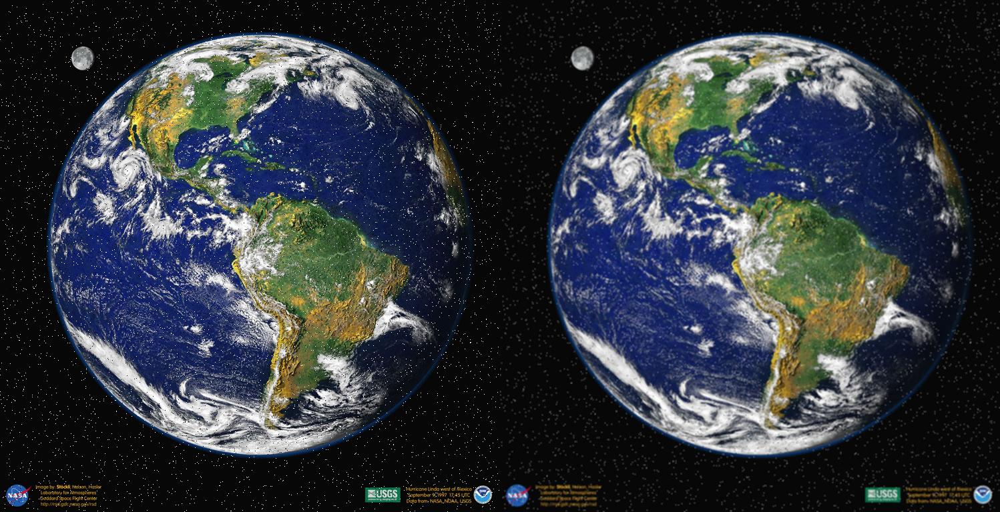

In [ ]:

# Set the kernel size and stride
kernel_size = 3
jump_rate = 1

# Apply the averaging filter with stride
blurred_image = apply_averaging_filter(noisy_img, kernel_size, jump_rate)

# Display the original and blurred images
res_filter_avg = np.hstack((noisy_img,blurred_image)) #stacking images side-by-side
cv2_imshow(res_filter_avg)

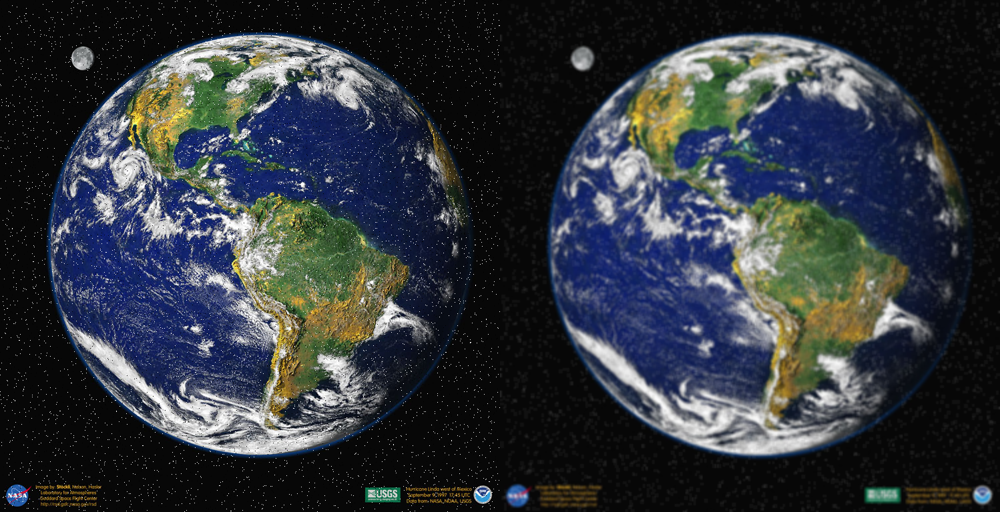

In [ ]:
# Set the kernel size and stride
kernel_size = 5
jump_rate = 2

# Apply the averaging filter with stride
blurred_image = apply_averaging_filter(noisy_img, kernel_size, jump_rate)

# make the sizes the same
width, height = noisy_img.shape[:2]
resized_image = cv2.resize(blurred_image, (height, width))

# Display the original and blurred images
res_filter_avg = np.hstack((noisy_img,resized_image)) #stacking images side-by-side
cv2_imshow(res_filter_avg)

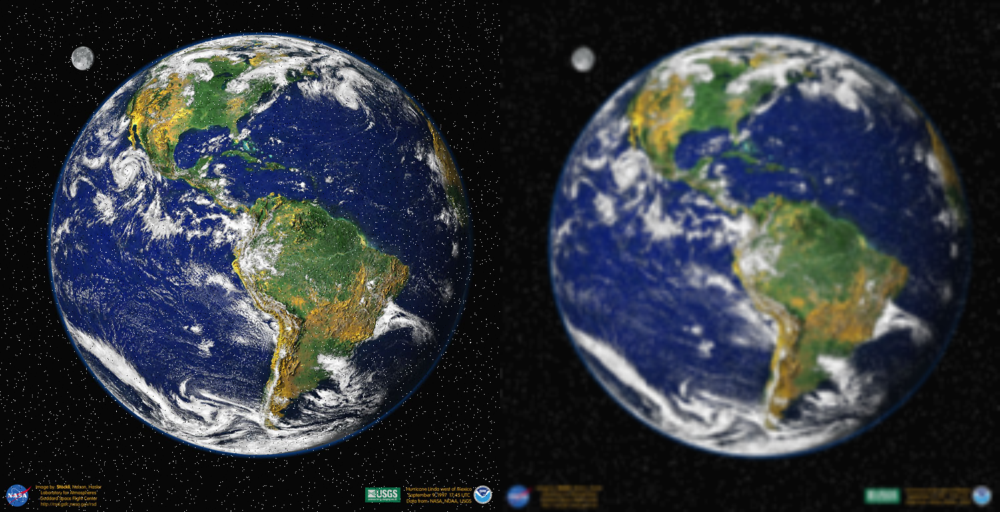

In [ ]:
# Set the kernel size and stride
kernel_size = 7
jump_rate = 4

# Apply the averaging filter with stride
blurred_image = apply_averaging_filter(noisy_img, kernel_size, jump_rate)

# make the sizes the same
width, height = noisy_img.shape[:2]
resized_image = cv2.resize(blurred_image, (height, width))

# Display the original and blurred images
res_filter_avg = np.hstack((noisy_img,resized_image)) #stacking images side-by-side
cv2_imshow(res_filter_avg)

# 3_c) Median filter

In [ ]:
def apply_median_filter(image, kernel_size, stride):
    # Create an empty output image
    output = np.zeros_like(image)

    # Apply stride on the median filter
    for i in range(0, image.shape[0] - kernel_size + 1, stride):
        for j in range(0, image.shape[1] - kernel_size + 1, stride):
            roi = image[i:i+kernel_size, j:j+kernel_size]
            median_value = np.median(roi)
            output[i:i+kernel_size, j:j+kernel_size] = median_value

    return output

def apply_filter_on_channels(image, kernel_size, stride):
    # Split the image into channels
    channels = cv2.split(image)

    # Create an empty list to store filtered channels
    filtered_channels = []

    # Apply filter on each channel
    for channel in channels:
        filtered_channel = apply_median_filter(channel, kernel_size, stride)
        filtered_channels.append(filtered_channel)

    # Merge filtered channels into a single image
    filtered_image = cv2.merge(filtered_channels)

    return filtered_image


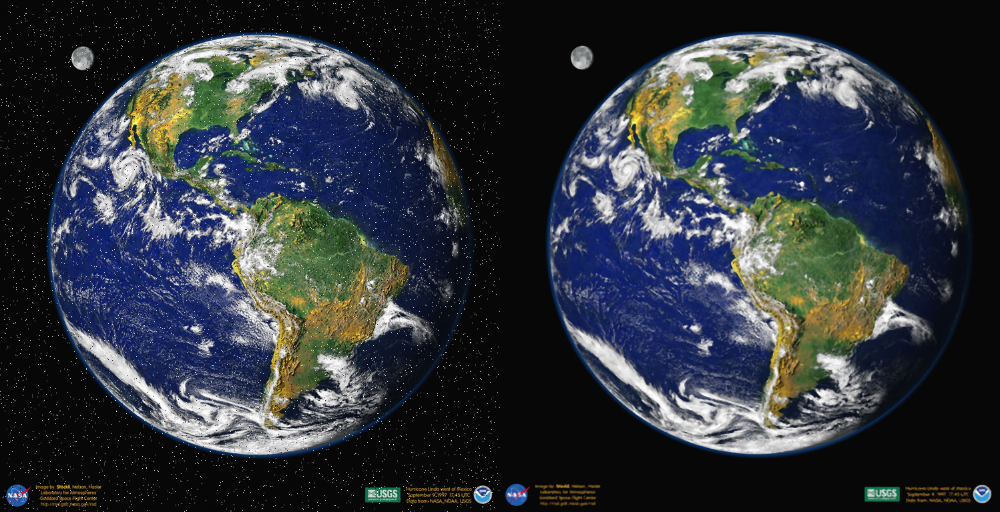

In [ ]:

# Apply median filter with kernel_size=3 and stride=1
filtered_img = apply_filter_on_channels(noisy_img, kernel_size=3, stride=1)

# Display the filtered image
res_filter_median = np.hstack((noisy_img,filtered_img)) #stacking images side-by-side
cv2_imshow(res_filter_median)


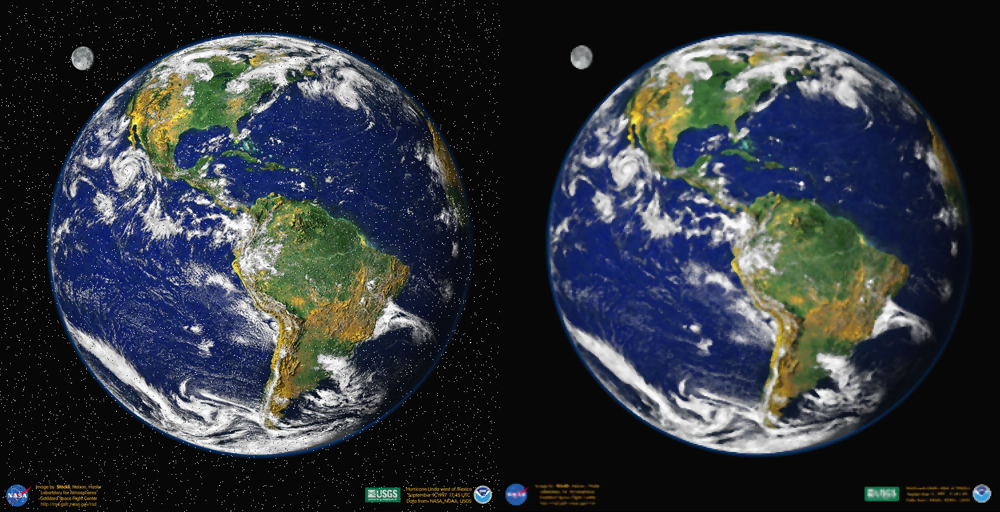

In [ ]:
# Apply median filter with kernel_size=5 and stride=2
filtered_img = apply_filter_on_channels(noisy_img, kernel_size=5, stride=2)

# Display the filtered image
res_filter_median = np.hstack((noisy_img,filtered_img)) #stacking images side-by-side
cv2_imshow(res_filter_median)


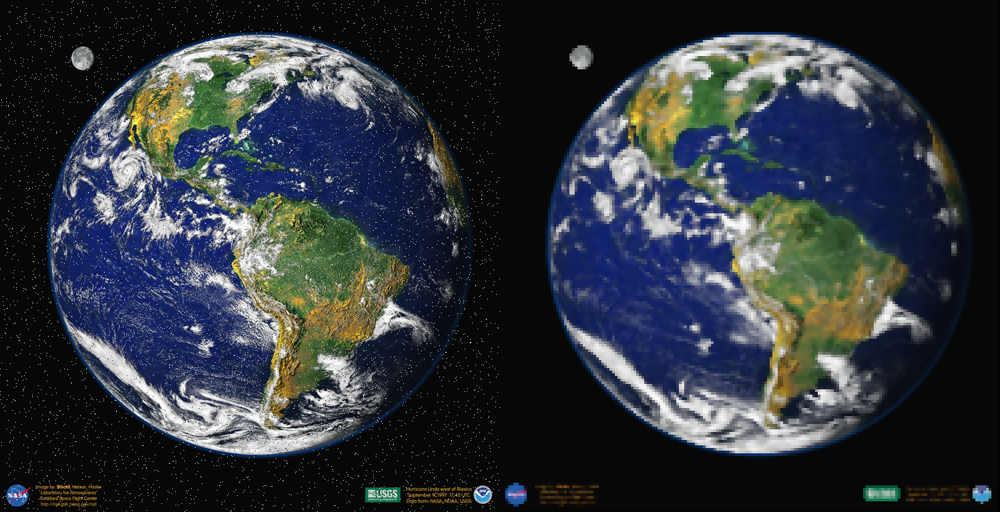

In [ ]:
# Apply median filter with kernel_size=7 and stride=4
filtered_img = apply_filter_on_channels(noisy_img, kernel_size=7, stride=4)

# Display the filtered image
res_filter_median = np.hstack((noisy_img,filtered_img)) #stacking images side-by-side
cv2_imshow(res_filter_median)


# 3_d) Gussian filter

In [ ]:
def Gaussian_filter(image, kernel_size):
  # Apply a Gaussian filter with a kernel size of 5 and sigma of 0
  filtered_image = cv2.GaussianBlur(image, (kernel_size, kernel_size), 0)

  return filtered_image


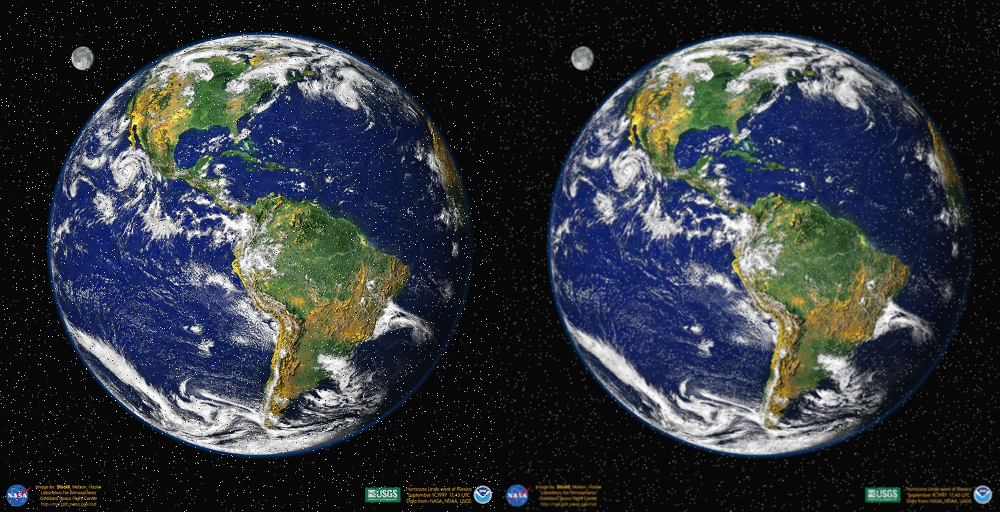

In [ ]:
# setting kernel size
kernel_size = 3

# Apply the gaussian filter
blurred_image = Gaussian_filter(noisy_img, kernel_size)

# Display the original and blurred images
res_filter_avg = np.hstack((noisy_img,blurred_image)) #stacking images side-by-side
cv2_imshow(res_filter_avg)

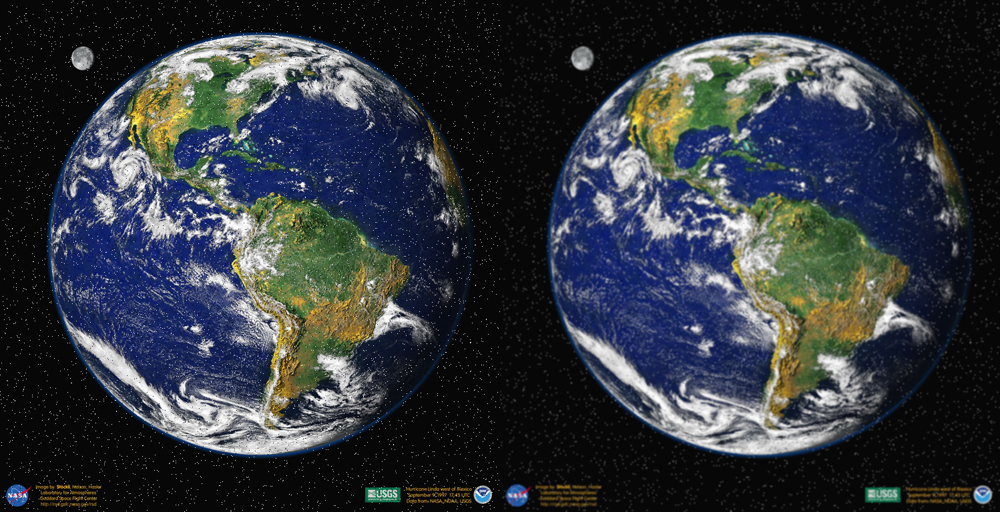

In [ ]:
# setting kernel size
kernel_size = 5

# Apply the gaussian filter
blurred_image = Gaussian_filter(noisy_img, kernel_size)

# Display the original and blurred images
res_filter_avg = np.hstack((noisy_img,blurred_image)) #stacking images side-by-side
cv2_imshow(res_filter_avg)

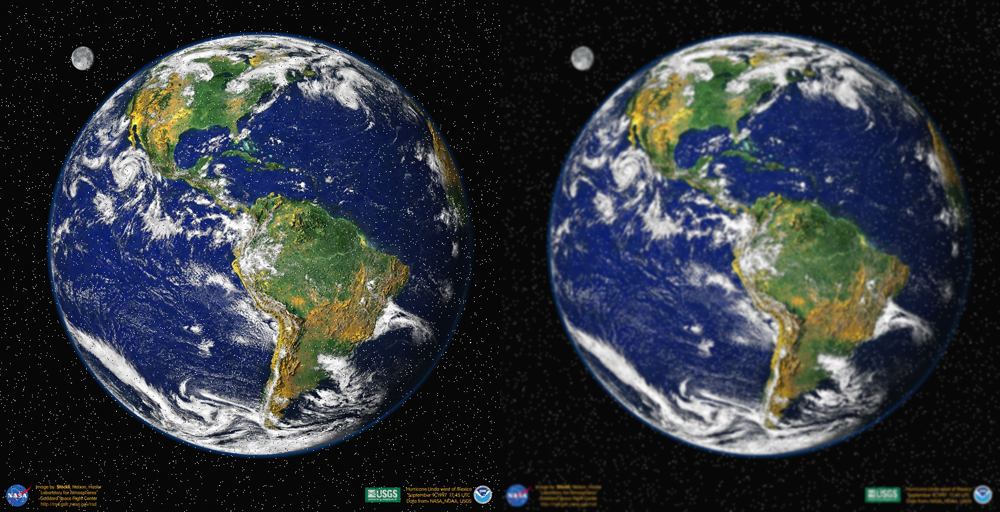

In [ ]:
# setting kernel size
kernel_size = 7

# Apply the gaussian filter
blurred_image = Gaussian_filter(noisy_img, kernel_size)

# Display the original and blurred images
res_filter_avg = np.hstack((noisy_img,blurred_image)) #stacking images side-by-side
cv2_imshow(res_filter_avg)

# 3_e) Conclusion

* Totally, filters with higher kernel size can remove
noise better but the output image is more faded.

* In addition, Median filter performes better than the others.

* In summary, Median filter with a kernel size of 3 is the best in comparision with others.(only in the case that was checked)

# 4_a) Compute the derivatives

In [ ]:
def compute_image_derivatives(image):
    # Compute the x and y derivatives using the Sobel operator
    dx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    dy = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)

    return dx, dy

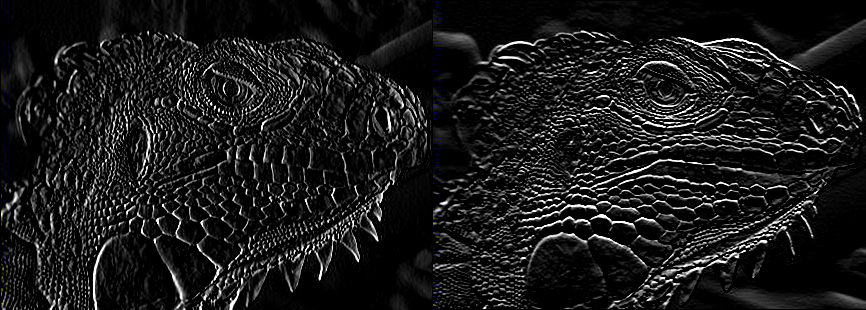

In [ ]:
path_img_iguana = '/content/Machine-vision-spring-2023/homework4/iguana.png'

# Load the image in grayscale
image_iguana = cv2.imread(path_img_iguana)

# Compute the derivatives
dx, dy = compute_image_derivatives(image_iguana)

# display dx and dy
res_dericatives = np.hstack((dx, dy))
cv2_imshow(res_dericatives)

# 4_b) Gradient and Threshold

In [ ]:

def compute_gradient_threshold(image, threshold):
    # Apply the Sobel operator to compute gradients
    gradient_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    gradient_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)

    # Compute the magnitude of gradients
    gradient_magnitude = np.sqrt(gradient_x**2 + gradient_y**2)

    # Compute the threshold based on arctan of gradients
    gradient_theta = np.arctan2(gradient_y, gradient_x)

    # detect the edges
    edge_detected = np.zeros(image.shape, dtype=np.uint8)
    edge_detected[gradient_magnitude > threshold] = 255
    
    return edge_detected, gradient_magnitude, gradient_theta


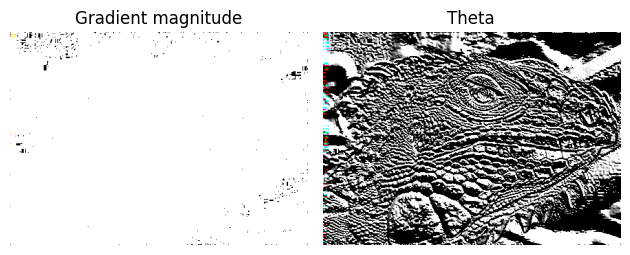

In [ ]:
# Load the image in grayscale
image_iguana = cv2.imread(path_img_iguana)

edge_detected, gradient, theta = compute_gradient_threshold(image_iguana, 200)

#display gradient and threshold
plt.subplot(1, 2, 1), plt.imshow(gradient, cmap='gray')
plt.title('Gradient magnitude'), plt.axis('off')
plt.subplot(1, 2, 2), plt.imshow(theta, cmap='gray')
plt.title('Theta'), plt.axis('off')
plt.subplots_adjust(wspace=0.05, hspace=0.05)
plt.tight_layout()
plt.show()


(-0.5, 432.5, 309.5, -0.5)

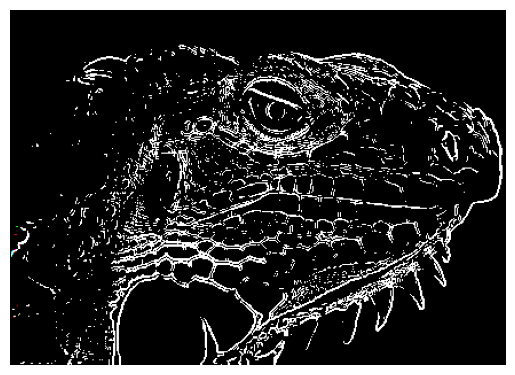

In [ ]:
plt.imshow(edge_detected)
plt.axis('off')

# 4_c) canny and sobel filters

In [ ]:

def canny_edge_detection(image, threshold):
    # Convert image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Perform Canny edge detection
    edges = cv2.Canny(blurred, threshold, threshold * 2)

    return edges


def sobel_edge_detection(image, threshold):
    # Convert image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Calculate gradients using Sobel operator
    sobel_x = cv2.Sobel(blurred, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(blurred, cv2.CV_64F, 0, 1, ksize=3)

    # Calculate magnitude of gradients
    magnitude = np.sqrt(sobel_x**2 + sobel_y**2)

    # Normalize the magnitude to 0-255
    magnitude = np.uint8(magnitude / np.max(magnitude) * 255)

    # Apply threshold to obtain binary image
    edges = cv2.threshold(magnitude, threshold, 255, cv2.THRESH_BINARY)[1]

    return edges


In [ ]:
earth_path = '/content/Machine-vision-spring-2023/homework4/planet/Earth.bmp'
sun_path = '/content/Machine-vision-spring-2023/homework4/planet/Sun.bmp'
uranus_path = '/content/Machine-vision-spring-2023/homework4/planet/Uranus.bmp'

img_earth = cv2.imread(earth_path)
img_sun = cv2.imread(sun_path)
img_uranus = cv2.imread(uranus_path)

In [ ]:
# apply canny on planet images
earth_canny_edges = canny_edge_detection(img_earth, 50)
sun_canny_edges = canny_edge_detection(img_sun, 50)
uranus_canny_edges = canny_edge_detection(img_uranus, 50)

# apply sobel on planet images
earth_sobel_edges = sobel_edge_detection(img_earth, 50)
sun_sobel_edges = sobel_edge_detection(img_sun, 50)
uranus_sobel_edges = sobel_edge_detection(img_uranus, 50)

In [ ]:
# Resize the images
width, height = 700, 700  # Choose a common size for all images
earth_canny_edges = cv2.resize(earth_canny_edges, (width, height))
sun_canny_edges = cv2.resize(sun_canny_edges, (width, height))
uranus_canny_edges = cv2.resize(uranus_canny_edges, (width, height))

earth_sobel_edges = cv2.resize(earth_sobel_edges, (width, height))
sun_sobel_edges = cv2.resize(sun_sobel_edges, (width, height))
uranus_sobel_edges = cv2.resize(uranus_sobel_edges, (width, height))


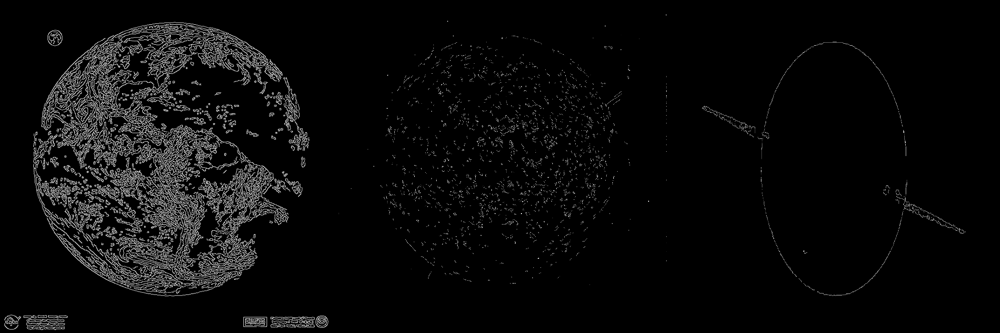

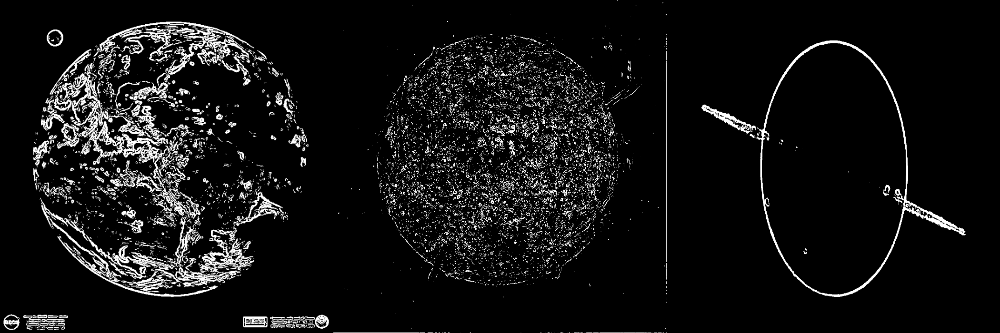

In [ ]:

# display canny result
res_canny = np.hstack((earth_canny_edges, sun_canny_edges, uranus_canny_edges))
cv2_imshow(res_canny)

# display sobel result
res_sobel = np.hstack((earth_sobel_edges, sun_sobel_edges, uranus_sobel_edges))
cv2_imshow(res_sobel)


# 4_d) Compare the used methods for edge detection:

Canny is more accurate, resistant to noise, and produces thinner edges.

Sobel is less computationally complex.

If the application is edge detection in general, Sobel can meet the goal. whereas Canny is a better choice in object detection, image segmentation, and feature extraction.

# 5) Canny edge detector

In [2]:
def canny_edge_detector(image, t_lower, t_upper):
  edges = cv2.Canny(image,t_lower,t_upper)
  return edges

# Setting parameter values
t_lower = 100  # Lower Threshold
t_upper = 150  # Upper threshold


In [11]:
# Grab images
road_path = '/content/Machine-vision-spring-2023/homework4/road.jpg'
sudoku_path = '/content/Machine-vision-spring-2023/homework4/sudoku.png'

img_road = cv2.imread(road_path)
img_sudoku = cv2.imread(sudoku_path)

# detect edges
road_edge = canny_edge_detector(img_road, t_lower, t_upper)
sudoku_edge = canny_edge_detector(img_sudoku, t_lower, t_upper)

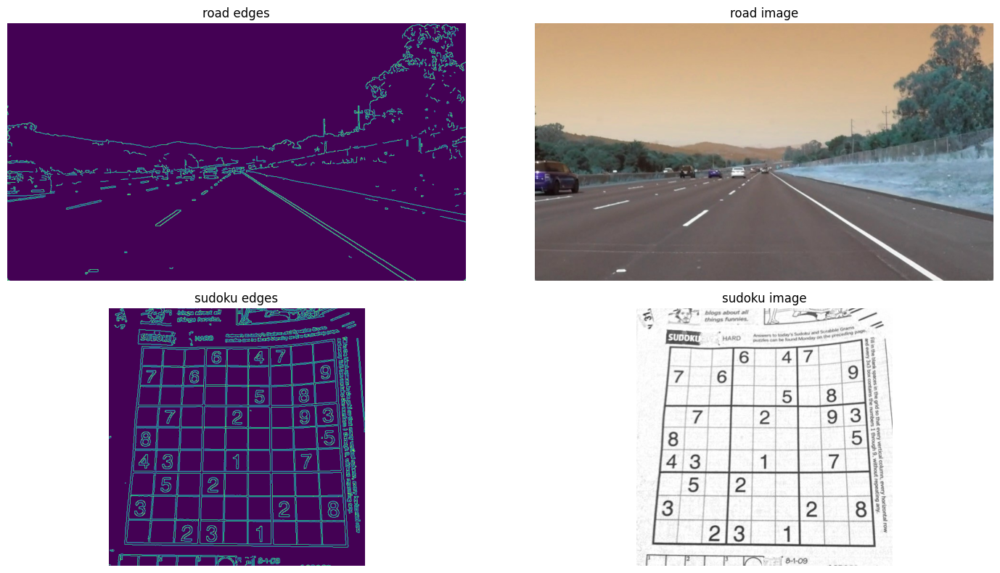

In [19]:

# display the edges of road image
fig, axes = plt.subplots(2, 2, figsize=(15, 8))

axes[0,0].imshow(road_edge)
axes[0,0].set_title('road edges')
axes[0,0].axis('off')

axes[0,1].imshow(img_road)
axes[0,1].set_title('road image')
axes[0,1].axis('off')

axes[1,0].imshow(sudoku_edge)
axes[1,0].set_title('sudoku edges')
axes[1,0].axis('off')

axes[1,1].imshow(img_sudoku)
axes[1,1].set_title('sudoku image')
axes[1,1].axis('off')

plt.tight_layout()
plt.show()


# 5) Hough Transform

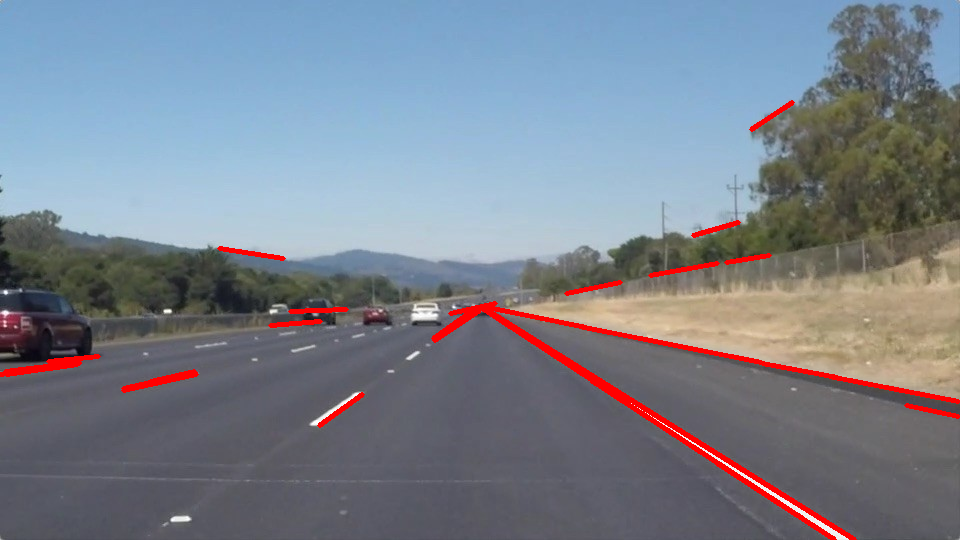

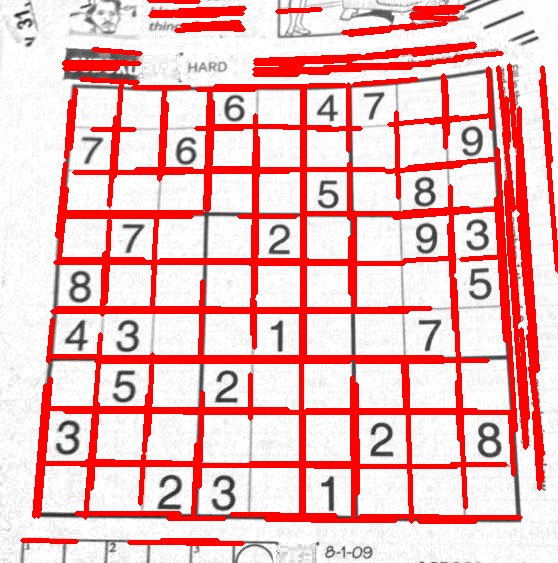

In [20]:
def draw_lines(image, image_edges):
    img_copy = image.copy()
    # Detect points that form a line
    lines = cv2.HoughLinesP(
                image_edges, # Input edge image
                1, # Distance resolution in pixels
                np.pi/180, # Angle resolution in radians
                threshold=50, # Min number of votes for valid line
                minLineLength=40, # Min allowed length of line
                maxLineGap=5 # Max allowed gap between line for joining them
                )
    
    # Draw lines on the image
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(img_copy, (x1, y1), (x2, y2), (0, 0, 255), 3)
    return img_copy

road_lines = draw_lines(img_road, road_edge)
sudoku_lines = draw_lines(img_sudoku, sudoku_edge)

# Show results
cv2_imshow(road_lines)
cv2_imshow(sudoku_lines)
